<div>
    
</div>

<div>
    <h2>Final Project</h2>
    <h4>Group submission by:</h4>
    <ul>
        <li>Ajay Krishna Ayyappan - 100938063</li>
        <li>Kadamandla Sharon - 100929268</li>
        <li>Priyanka Choudhary - 100940752</li>
        <li>Sairaj Udayshankar - 100865420</li>
    </ul>
</div>

Importing libraries and getting the data

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

In [2]:
df = pd.read_csv("house_price.csv")

Observing the data

In [3]:
df.head(10)

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,1800,7503
5,7237550310,20140512T000000,1230000.0,4,4.50,5420,101930,1.0,0,0,3,11,3890,1530,2001,0,98053,4760,101930
6,1321400060,20140627T000000,257500.0,3,2.25,1715,6819,2.0,0,0,3,7,1715,0,1995,0,98003,2238,6819
7,2008000270,20150115T000000,291850.0,3,1.50,1060,9711,1.0,0,0,3,7,1060,0,1963,0,98198,1650,9711
8,2414600126,20150415T000000,229500.0,3,1.00,1780,7470,1.0,0,0,3,7,1050,730,1960,0,98146,1780,8113
9,3793500160,20150312T000000,323000.0,3,2.50,1890,6560,2.0,0,0,3,7,1890,0,2003,0,98038,2390,7570


Dropping unnecessary columns

In [4]:
df.drop(columns=["id", "date"], inplace=True)

Understanding the data and data types

In [5]:
df.zipcode.nunique()

70

In [6]:
df.zipcode.unique()

array([98178, 98125, 98028, 98136, 98074, 98053, 98003, 98198, 98146,
       98038, 98007, 98115, 98107, 98126, 98019, 98103, 98002, 98133,
       98040, 98092, 98030, 98119, 98112, 98052, 98027, 98117, 98058,
       98001, 98056, 98166, 98023, 98070, 98148, 98105, 98042, 98008,
       98059, 98122, 98144, 98004, 98005, 98034, 98075, 98116, 98010,
       98118, 98199, 98032, 98045, 98102, 98077, 98108, 98168, 98177,
       98065, 98029, 98006, 98109, 98022, 98033, 98155, 98024, 98011,
       98031, 98106, 98072, 98188, 98014, 98055, 98039], dtype=int64)

In [7]:
df.zipcode = df.zipcode.astype('str')

In [8]:
# We see there are 70 different types of zipcodes. 70 columns would be too much for one-hot encoding.
# Hence, creating a new feature by grouping codes that start with 980 and 981, we get:

In [9]:
df['zip_group'] = df['zipcode'].str.startswith('981').astype(int)

In [10]:
df['zip_group']

0        1
1        1
2        0
3        1
4        0
        ..
21608    1
21609    1
21610    1
21611    0
21612    1
Name: zip_group, Length: 21613, dtype: int32

In [11]:
one_hot = pd.get_dummies(df['zip_group'], prefix='zip_').replace([True, False], [1, 0])
df = df.drop('zip_group', axis=1)
df = df.join(one_hot)

In [12]:
df.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,sqft_living15,sqft_lot15,zip__0,zip__1
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,98178,1340,5650,0,1
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,98125,1690,7639,0,1
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,98028,2720,8062,1,0
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,98136,1360,5000,0,1
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,98074,1800,7503,1,0


In [13]:
df.drop(columns=['zipcode'], inplace=True)

In [14]:
df

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,sqft_living15,sqft_lot15,zip__0,zip__1
0,221900.0,3,1.00,1180,5650,1.0,0,0,3,7,1180,0,1955,0,1340,5650,0,1
1,538000.0,3,2.25,2570,7242,2.0,0,0,3,7,2170,400,1951,1991,1690,7639,0,1
2,180000.0,2,1.00,770,10000,1.0,0,0,3,6,770,0,1933,0,2720,8062,1,0
3,604000.0,4,3.00,1960,5000,1.0,0,0,5,7,1050,910,1965,0,1360,5000,0,1
4,510000.0,3,2.00,1680,8080,1.0,0,0,3,8,1680,0,1987,0,1800,7503,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,360000.0,3,2.50,1530,1131,3.0,0,0,3,8,1530,0,2009,0,1530,1509,0,1
21609,400000.0,4,2.50,2310,5813,2.0,0,0,3,8,2310,0,2014,0,1830,7200,0,1
21610,402101.0,2,0.75,1020,1350,2.0,0,0,3,7,1020,0,2009,0,1020,2007,0,1
21611,400000.0,3,2.50,1600,2388,2.0,0,0,3,8,1600,0,2004,0,1410,1287,1,0


One hot encoding all categorical variables

In [15]:
categorical_features = ['waterfront', 'view', 'condition', 'grade']

In [16]:
for feature in categorical_features:
    one_hot = pd.get_dummies(df[feature], prefix=feature).replace([True, False], [1, 0])
    df = df.drop(feature, axis=1)
    df = df.join(one_hot)

In [17]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'yr_built', 'yr_renovated',
       'sqft_living15', 'sqft_lot15', 'zip__0', 'zip__1', 'waterfront_0',
       'waterfront_1', 'view_0', 'view_1', 'view_2', 'view_3', 'view_4',
       'condition_1', 'condition_2', 'condition_3', 'condition_4',
       'condition_5', 'grade_1', 'grade_3', 'grade_4', 'grade_5', 'grade_6',
       'grade_7', 'grade_8', 'grade_9', 'grade_10', 'grade_11', 'grade_12',
       'grade_13'],
      dtype='object')

In [18]:
df.yr_built.nunique()

116

In [19]:
df.yr_built.unique()

array([1955, 1951, 1933, 1965, 1987, 2001, 1995, 1963, 1960, 2003, 1942,
       1927, 1977, 1900, 1979, 1994, 1916, 1921, 1969, 1947, 1968, 1985,
       1941, 1915, 1909, 1948, 2005, 1929, 1981, 1930, 1904, 1996, 2000,
       1984, 2014, 1922, 1959, 1966, 1953, 1950, 2008, 1991, 1954, 1973,
       1925, 1989, 1972, 1986, 1956, 2002, 1992, 1964, 1952, 1961, 2006,
       1988, 1962, 1939, 1946, 1967, 1975, 1980, 1910, 1983, 1978, 1905,
       1971, 2010, 1945, 1924, 1990, 1914, 1926, 2004, 1923, 2007, 1976,
       1949, 1999, 1901, 1993, 1920, 1997, 1943, 1957, 1940, 1918, 1928,
       1974, 1911, 1936, 1937, 1982, 1908, 1931, 1998, 1913, 2013, 1907,
       1958, 2012, 1912, 2011, 1917, 1932, 1944, 1902, 2009, 1903, 1970,
       2015, 1934, 1938, 1919, 1906, 1935], dtype=int64)

In [20]:
df['year_built_category'] = pd.cut(df['yr_built'], bins=[-float('inf'), 1950, 2000, float('inf')], labels=['before_1950', '1950_2000', 'after_2000'], right=False)

In [21]:
one_hot = pd.get_dummies(df['year_built_category'], prefix='year_built').replace([True, False], [1, 0])
df = df.drop('year_built_category', axis=1)
df = df.drop('yr_built', axis=1)
df = df.join(one_hot)

In [22]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'yr_renovated', 'sqft_living15',
       'sqft_lot15', 'zip__0', 'zip__1', 'waterfront_0', 'waterfront_1',
       'view_0', 'view_1', 'view_2', 'view_3', 'view_4', 'condition_1',
       'condition_2', 'condition_3', 'condition_4', 'condition_5', 'grade_1',
       'grade_3', 'grade_4', 'grade_5', 'grade_6', 'grade_7', 'grade_8',
       'grade_9', 'grade_10', 'grade_11', 'grade_12', 'grade_13',
       'year_built_before_1950', 'year_built_1950_2000',
       'year_built_after_2000'],
      dtype='object')

In [23]:
df.yr_renovated.nunique()

70

In [24]:
df.yr_renovated.unique()

array([   0, 1991, 2002, 2010, 1999, 1992, 2013, 1994, 1978, 2005, 2008,
       2003, 1984, 1954, 2014, 2011, 1974, 1983, 1945, 1990, 1988, 1957,
       1977, 1981, 1995, 2000, 1998, 1970, 1989, 2004, 1986, 2009, 2007,
       1987, 1973, 2006, 1985, 2001, 1980, 1971, 1979, 1997, 1950, 1969,
       1948, 2015, 1968, 2012, 1963, 1951, 1993, 1962, 1996, 1972, 1953,
       1955, 1982, 1956, 1940, 1976, 1946, 1975, 1958, 1964, 1959, 1960,
       1967, 1965, 1934, 1944], dtype=int64)

In [25]:
df['yr_renovated_category'] = pd.cut(df['yr_renovated'], bins=[-float('inf'), 1950, 2000, float('inf')], labels=['before_1950', '1950_2000', 'after_2000'], right=False)

In [26]:
one_hot = pd.get_dummies(df['yr_renovated_category'], prefix='year_renovated').replace([True, False], [1, 0])
df = df.drop('yr_renovated_category', axis=1)
df = df.drop('yr_renovated', axis=1)
df = df.join(one_hot)

In [27]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15', 'zip__0',
       'zip__1', 'waterfront_0', 'waterfront_1', 'view_0', 'view_1', 'view_2',
       'view_3', 'view_4', 'condition_1', 'condition_2', 'condition_3',
       'condition_4', 'condition_5', 'grade_1', 'grade_3', 'grade_4',
       'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_9', 'grade_10',
       'grade_11', 'grade_12', 'grade_13', 'year_built_before_1950',
       'year_built_1950_2000', 'year_built_after_2000',
       'year_renovated_before_1950', 'year_renovated_1950_2000',
       'year_renovated_after_2000'],
      dtype='object')

Dimensionality reduction for grade columns

In [28]:
df['grades_0'] = df['grade_1'] + df['grade_3'] + df['grade_4'] + df['grade_5']

In [29]:
df['grades_1'] = df['grade_6'] + df['grade_7'] + df['grade_8'] + df['grade_9']

In [30]:
df['grades_2'] = df['grade_10'] + df['grade_11'] + df['grade_12'] + df['grade_13']

In [31]:
df.drop(columns=['grade_1', 'grade_3', 'grade_4', 'grade_5', 'grade_6', 'grade_7', 'grade_8', 'grade_9', 'grade_10', 'grade_11', 'grade_12', 'grade_13'], inplace=True)

In [32]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15', 'zip__0',
       'zip__1', 'waterfront_0', 'waterfront_1', 'view_0', 'view_1', 'view_2',
       'view_3', 'view_4', 'condition_1', 'condition_2', 'condition_3',
       'condition_4', 'condition_5', 'year_built_before_1950',
       'year_built_1950_2000', 'year_built_after_2000',
       'year_renovated_before_1950', 'year_renovated_1950_2000',
       'year_renovated_after_2000', 'grades_0', 'grades_1', 'grades_2'],
      dtype='object')

In [33]:
df['grades_0'].value_counts()

grades_0
0    21338
1      275
Name: count, dtype: int64

In [34]:
df['grades_1'].value_counts()

grades_1
1    19702
0     1911
Name: count, dtype: int64

In [35]:
df['grades_2'].value_counts()

grades_2
0    19977
1     1636
Name: count, dtype: int64

In [36]:
df.columns

Index(['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15', 'zip__0',
       'zip__1', 'waterfront_0', 'waterfront_1', 'view_0', 'view_1', 'view_2',
       'view_3', 'view_4', 'condition_1', 'condition_2', 'condition_3',
       'condition_4', 'condition_5', 'year_built_before_1950',
       'year_built_1950_2000', 'year_built_after_2000',
       'year_renovated_before_1950', 'year_renovated_1950_2000',
       'year_renovated_after_2000', 'grades_0', 'grades_1', 'grades_2'],
      dtype='object')

In [37]:
std = StandardScaler()
scaled_df = std.fit_transform(df)

In [38]:
type(scaled_df)

numpy.ndarray

In [39]:
scaled_df = pd.DataFrame(scaled_df, columns=df.columns)

In [40]:
px.box(scaled_df[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']])

In [41]:
#Removal of outlier:
scaled_df1 = scaled_df.copy()
for i in ['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors', 'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']:
    Q1 = scaled_df1[i].quantile(0.25)
    Q3 = scaled_df1[i].quantile(0.75)
    IQR = Q3-Q1
    scaled_df1 = scaled_df1[scaled_df1[i] <= (Q3+(1.5*IQR))]
    scaled_df1 = scaled_df1[scaled_df1[i] >= (Q1-(1.5*IQR))]
    scaled_df1 = scaled_df1.reset_index(drop=True)
display(scaled_df1.head())
print('Result:\nBefore removal of outliers, The dataset had {} samples.'.format(scaled_df.shape[0]))
print('After removal of outliers, The dataset now has {} samples.'.format(scaled_df1.shape[0]))

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,sqft_above,sqft_basement,sqft_living15,sqft_lot15,...,condition_5,year_built_before_1950,year_built_1950_2000,year_built_after_2000,year_renovated_before_1950,year_renovated_1950_2000,year_renovated_after_2000,grades_0,grades_1,grades_2
0,-0.866419,-0.398737,-1.447464,-0.979835,-0.228321,-0.915427,-0.734708,-0.658681,-0.943355,-0.260715,...,-0.292277,-0.544109,0.902013,-0.531381,0.208932,-0.145157,-0.147138,-0.113524,0.311441,-0.286172
1,-0.005940,-0.398737,0.175607,0.533634,-0.189885,0.936506,0.460841,0.245141,-0.432686,-0.187868,...,-0.292277,-0.544109,0.902013,-0.531381,-4.786250,6.889096,-0.147138,-0.113524,0.311441,-0.286172
2,-0.980478,-1.473959,-1.447464,-1.426254,-0.123298,-0.915427,-1.229834,-0.658681,1.070140,-0.172375,...,-0.292277,1.837868,-1.108631,-0.531381,0.208932,-0.145157,-0.147138,-0.113524,0.311441,-0.286172
3,0.173723,0.676485,1.149449,-0.130550,-0.244014,-0.915427,-0.891699,1.397515,-0.914174,-0.284522,...,3.421411,-0.544109,0.902013,-0.531381,0.208932,-0.145157,-0.147138,-0.113524,0.311441,-0.286172
4,-0.082161,-0.398737,-0.149007,-0.435422,-0.169653,-0.915427,-0.130895,-0.658681,-0.272190,-0.192849,...,-0.292277,-0.544109,0.902013,-0.531381,0.208932,-0.145157,-0.147138,-0.113524,0.311441,-0.286172


Result:
Before removal of outliers, The dataset had 21613 samples.
After removal of outliers, The dataset now has 16217 samples.


In [42]:
px.box(scaled_df1[['price', 'bedrooms', 'bathrooms', 'sqft_living', 'sqft_lot', 'floors',
       'sqft_above', 'sqft_basement', 'sqft_living15', 'sqft_lot15']])

In [43]:
target = 'price'
features = [i for i in scaled_df1.columns if i not in [target]]

In [44]:
target

'price'

In [45]:
features

['bedrooms',
 'bathrooms',
 'sqft_living',
 'sqft_lot',
 'floors',
 'sqft_above',
 'sqft_basement',
 'sqft_living15',
 'sqft_lot15',
 'zip__0',
 'zip__1',
 'waterfront_0',
 'waterfront_1',
 'view_0',
 'view_1',
 'view_2',
 'view_3',
 'view_4',
 'condition_1',
 'condition_2',
 'condition_3',
 'condition_4',
 'condition_5',
 'year_built_before_1950',
 'year_built_1950_2000',
 'year_built_after_2000',
 'year_renovated_before_1950',
 'year_renovated_1950_2000',
 'year_renovated_after_2000',
 'grades_0',
 'grades_1',
 'grades_2']

Splitting data into train, test and validation

In [46]:
train_df, test_df = train_test_split(scaled_df1, test_size=0.2, random_state=100)
train_df, val_df = train_test_split(train_df, test_size=0.3, random_state=100)

In [47]:
print("Train set shape:", train_df.shape)
print("Validation set shape:", val_df.shape)
print("Test set shape:", test_df.shape)

Train set shape: (9081, 33)
Validation set shape: (3892, 33)
Test set shape: (3244, 33)


In [48]:
train_df_y = train_df[target]
train_df_X = train_df[features]

In [49]:
test_df_y = test_df[target]
test_df_X = test_df[features]

In [50]:
val_df_y = val_df[target]
val_df_X = val_df[features]

Model Fitting

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import r2_score, mean_squared_error

plt.rcParams['figure.figsize'] = [10,6]

Model_Evaluation_Comparison_Matrix = pd.DataFrame(np.zeros([5,8]), columns=['Train-R2','Test-R2','Train-RSS','Test-RSS',
                                                                            'Train-MSE','Test-MSE','Train-RMSE','Test-RMSE'])
rc=np.random.choice(train_df_X.loc[:,train_df_X.nunique()>=50].columns.values,1,replace=False)
def Evaluate(n, pred1, pred2, pred3=None):
    #Plotting predicted predicteds alongside the actual datapoints 
    plt.figure(figsize=[15,6])
    for e,i in enumerate(rc):
        plt.subplot(2,3,e+1)
        plt.scatter(y=train_df_y, x=train_df_X[i], label='Actual')
        plt.scatter(y=pred1, x=train_df_X[i], label='Prediction')
        plt.legend()
    plt.show()

    #Evaluating the Multiple Linear Regression Model

    print('\n\n{}Training Set Metrics{}'.format('-'*20, '-'*20))
    print('\nR2-Score on Training set --->',round(r2_score(train_df_y, pred1),20))
    print('Residual Sum of Squares (RSS) on Training set  --->',round(np.sum(np.square(train_df_y-pred1)),20))
    print('Mean Squared Error (MSE) on Training set       --->',round(mean_squared_error(train_df_y, pred1),20))
    print('Root Mean Squared Error (RMSE) on Training set --->',round(np.sqrt(mean_squared_error(train_df_y, pred1)),20))

    print('\n{}Testing Set Metrics{}'.format('-'*20, '-'*20))
    print('\nR2-Score on Testing set --->',round(r2_score(test_df_y, pred2),20))
    print('Residual Sum of Squares (RSS) on Training set  --->',round(np.sum(np.square(test_df_y-pred2)),20))
    print('Mean Squared Error (MSE) on Training set       --->',round(mean_squared_error(test_df_y, pred2),20))
    print('Root Mean Squared Error (RMSE) on Training set --->',round(np.sqrt(mean_squared_error(test_df_y, pred2)),20))
    
    if pred3 is not None:
        print('\n{}Validating Set Metrics{}'.format('-'*20, '-'*20))
        print('\nR2-Score on Testing set --->',round(r2_score(val_df_y, pred3),20))
        print('Residual Sum of Squares (RSS) on Training set  --->',round(np.sum(np.square(val_df_y-pred3)),20))
        print('Mean Squared Error (MSE) on Training set       --->',round(mean_squared_error(val_df_y, pred3),20))
        print('Root Mean Squared Error (RMSE) on Training set --->',round(np.sqrt(mean_squared_error(val_df_y, pred3)),20))
        print('\n{}Residual Plots{}'.format('-'*20, '-'*20))
    
    Model_Evaluation_Comparison_Matrix.loc[n,'Train-R2']  = round(r2_score(train_df_y, pred1),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Test-R2']   = round(r2_score(test_df_y, pred2),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Train-RSS'] = round(np.sum(np.square(train_df_y-pred1)),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Test-RSS']  = round(np.sum(np.square(test_df_y-pred2)),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Train-MSE'] = round(mean_squared_error(train_df_y, pred1),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Test-MSE']  = round(mean_squared_error(test_df_y, pred2),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Train-RMSE']= round(np.sqrt(mean_squared_error(train_df_y, pred1)),20)
    Model_Evaluation_Comparison_Matrix.loc[n,'Test-RMSE'] = round(np.sqrt(mean_squared_error(test_df_y, pred2)),20)

    if pred3 is not None:
        Model_Evaluation_Comparison_Matrix.loc[n,'Val-R2']   = round(r2_score(val_df_y, pred3),20)
        Model_Evaluation_Comparison_Matrix.loc[n,'Val-RSS']  = round(np.sum(np.square(val_df_y-pred3)),20)
        Model_Evaluation_Comparison_Matrix.loc[n,'Val-MSE']  = round(mean_squared_error(val_df_y, pred3),20)
        Model_Evaluation_Comparison_Matrix.loc[n,'Val-RMSE'] = round(np.sqrt(mean_squared_error(val_df_y, pred3)),20)

    # Plotting y_test and y_pred to understand the spread.
    plt.figure(figsize=[15,4])

    plt.subplot(1,2,2)
    plt.scatter(train_df_y,pred1)
    plt.plot([train_df_y.min(), train_df_y.max()], [train_df_y.min(), train_df_y.max()], 'r--')
    plt.title('Test vs Prediction')         
    plt.xlabel('y_test')                       
    plt.ylabel('y_pred')                       
    plt.show()

<div style="display: flex; flex-direction: row; align-items: center; justify-content: center">
    <h5>Multiple Linear Regression</h5>
</div>

In [52]:
from sklearn.linear_model import LinearRegression
MLR = LinearRegression()

In [53]:
MLR.fit(train_df_X, train_df_y)

LinearRegression()

In [54]:
MLR.score(test_df_X, test_df_y)

0.44426770328424947

In [55]:
pred1 = MLR.predict(train_df_X)
pred2 = MLR.predict(test_df_X)

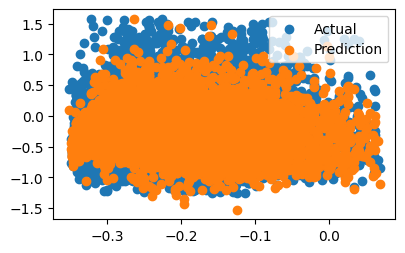



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.4476162146963633
Residual Sum of Squares (RSS) on Training set  ---> 1314.9915609507182
Mean Squared Error (MSE) on Training set       ---> 0.14480691123782824
Root Mean Squared Error (RMSE) on Training set ---> 0.38053503286534374

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> 0.44426770328424947
Residual Sum of Squares (RSS) on Training set  ---> 474.14871827348423
Mean Squared Error (MSE) on Training set       ---> 0.14616175039256607
Root Mean Squared Error (RMSE) on Training set ---> 0.3823110649622452

--------------------Residual Plots--------------------


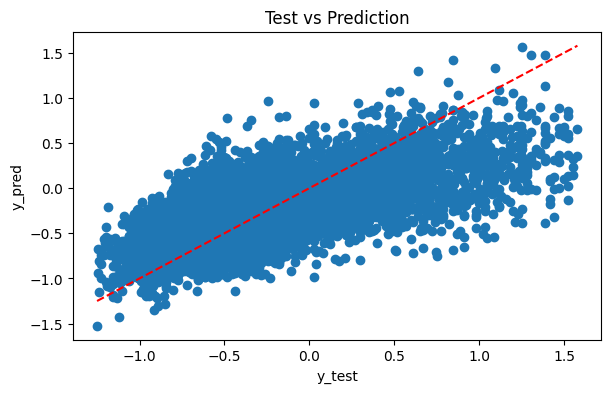

In [56]:
Evaluate(0, pred1, pred2)

Performing hyper-parameter tuning

In [57]:
MLR_tuned = LinearRegression(fit_intercept=False)
MLR_tuned.fit(train_df_X, train_df_y)

LinearRegression(fit_intercept=False)

In [58]:
MLR_tuned.score(test_df_X, test_df_y)

0.43145024014577116

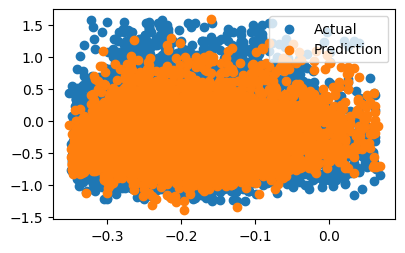



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.43696569404377783
Residual Sum of Squares (RSS) on Training set  ---> 1340.3459343963157
Mean Squared Error (MSE) on Training set       ---> 0.14759893562342424
Root Mean Squared Error (RMSE) on Training set ---> 0.3841860690126911

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> 0.43145024014577116
Residual Sum of Squares (RSS) on Training set  ---> 485.0845299125469
Mean Squared Error (MSE) on Training set       ---> 0.1495328390605878
Root Mean Squared Error (RMSE) on Training set ---> 0.38669476213234105

--------------------Residual Plots--------------------


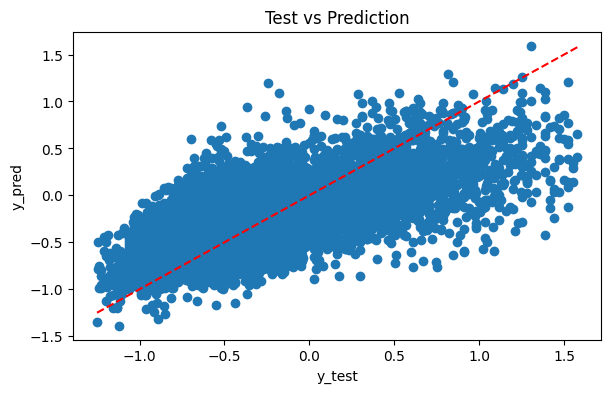

In [59]:
pred1 = MLR_tuned.predict(train_df_X)
pred2 = MLR_tuned.predict(test_df_X)
Evaluate(0, pred1, pred2)

<div style="display: flex; flex-direction: row; align-items: center; justify-content: center">
    <h5>Ridge Linear Regression</h5>
</div>

In [60]:
from sklearn.linear_model import Ridge
ridge = Ridge()

In [61]:
ridge.fit(train_df_X, train_df_y)

Ridge()

In [62]:
ridge.score(test_df_X, test_df_y)

0.4523201027894741

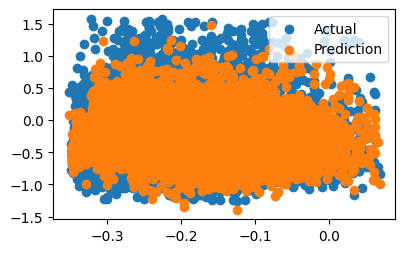



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.4549218434728438
Residual Sum of Squares (RSS) on Training set  ---> 1297.599956700007
Mean Squared Error (MSE) on Training set       ---> 0.142891747241494
Root Mean Squared Error (RMSE) on Training set ---> 0.3780102475350291

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> 0.45232010278947404
Residual Sum of Squares (RSS) on Training set  ---> 467.2784411148739
Mean Squared Error (MSE) on Training set       ---> 0.14404390909829654
Root Mean Squared Error (RMSE) on Training set ---> 0.37953117012743043

--------------------Residual Plots--------------------


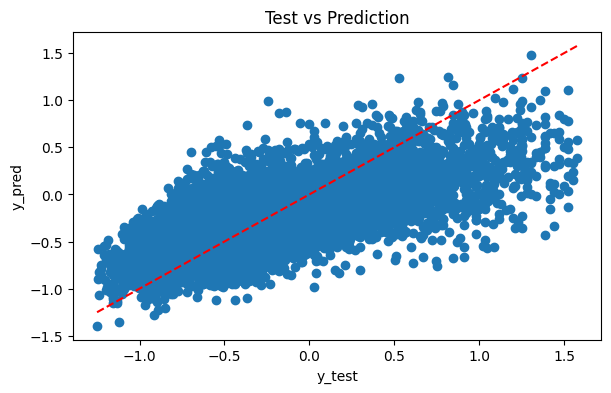

In [63]:
pred1 = ridge.predict(train_df_X)
pred2 = ridge.predict(test_df_X)
Evaluate(0, pred1, pred2)

<div style="display: flex; flex-direction: row; align-items: center; justify-content: center">
    <h5>Lasso Linear Regression</h5>
</div>

In [64]:
from sklearn.linear_model import Lasso
lasso = Lasso(fit_intercept=False)

In [65]:
lasso.fit(train_df_X, train_df_y)

Lasso(fit_intercept=False)

In [66]:
lasso.score(test_df_X, test_df_y)

-0.251884736986143

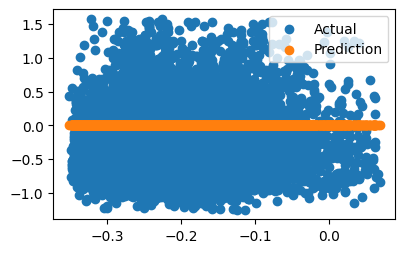



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> -0.2537308748774916
Residual Sum of Squares (RSS) on Training set  ---> 2984.6015832289995
Mean Squared Error (MSE) on Training set       ---> 0.3286644183712146
Root Mean Squared Error (RMSE) on Training set ---> 0.5732926114744673

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> -0.251884736986143
Residual Sum of Squares (RSS) on Training set  ---> 1068.10337814814
Mean Squared Error (MSE) on Training set       ---> 0.32925504875096795
Root Mean Squared Error (RMSE) on Training set ---> 0.5738075014767304

--------------------Residual Plots--------------------


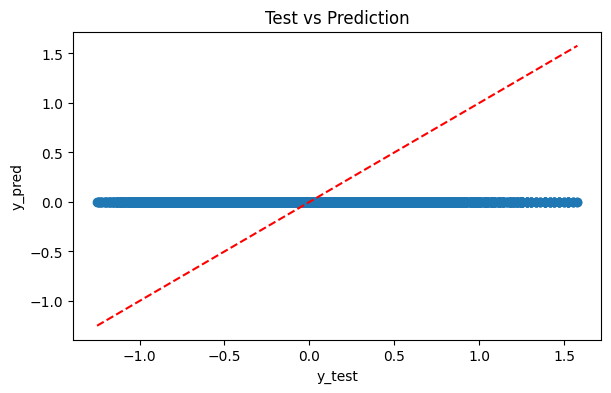

In [67]:
pred1 = lasso.predict(train_df_X)
pred2 = lasso.predict(test_df_X)
Evaluate(0, pred1, pred2)

<div style="display: flex; flex-direction: row; align-items: center; justify-content: center">
    <h5>ElasticNet Linear Regression</h5>
</div>

In [68]:
from sklearn.linear_model import ElasticNet
elasticNet = ElasticNet()

In [69]:
elasticNet.fit(train_df_X, train_df_y)

ElasticNet()

In [70]:
elasticNet.score(test_df_X, test_df_y)

-1.026563505091005e-06

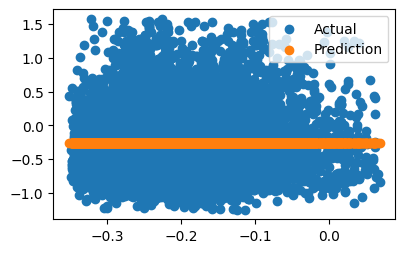



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.0
Residual Sum of Squares (RSS) on Training set  ---> 2380.5759617434965
Mean Squared Error (MSE) on Training set       ---> 0.26214909830894134
Root Mean Squared Error (RMSE) on Training set ---> 0.5120049787931181

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> -1.026563505091e-06
Residual Sum of Squares (RSS) on Training set  ---> 853.1971379373966
Mean Squared Error (MSE) on Training set       ---> 0.26300774905591756
Root Mean Squared Error (RMSE) on Training set ---> 0.5128428112549863

--------------------Residual Plots--------------------


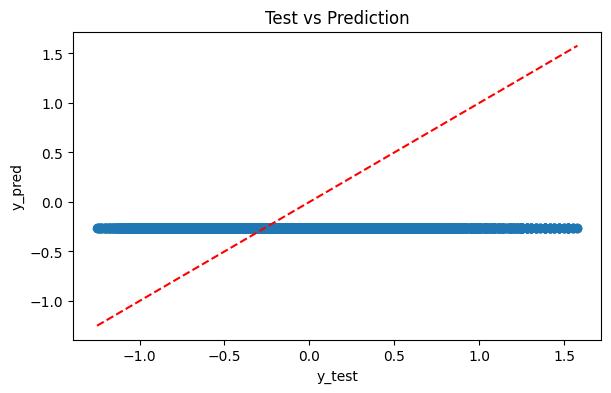

In [71]:
pred1 = elasticNet.predict(train_df_X)
pred2 = elasticNet.predict(test_df_X)
Evaluate(0, pred1, pred2)

<div style="display: flex; flex-direction: row; align-items: center; justify-content: center">
    <h5>Polynomial Regression</h5>
</div>

In [72]:
from sklearn.preprocessing import PolynomialFeatures

In [73]:
poly = PolynomialFeatures(degree=2, include_bias=False)

In [74]:
X_poly = poly.fit_transform(train_df_X)
X_poly1 = poly.fit_transform(test_df_X)

In [75]:
poly_model = LinearRegression()

In [76]:
poly_model.fit(X_poly, train_df_y)

LinearRegression()

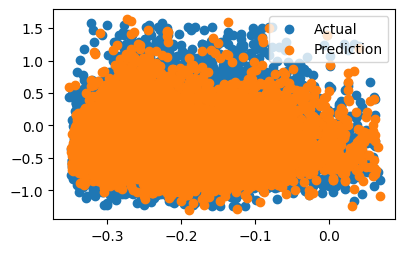



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.5579640769003049
Residual Sum of Squares (RSS) on Training set  ---> 1052.300092758231
Mean Squared Error (MSE) on Training set       ---> 0.1158793186607456
Root Mean Squared Error (RMSE) on Training set ---> 0.34041051490919844

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> -2.243773878428368e+23
Residual Sum of Squares (RSS) on Training set  ---> 1.9143794860216606e+26
Mean Squared Error (MSE) on Training set       ---> 5.901293113506968e+22
Root Mean Squared Error (RMSE) on Training set ---> 242925772891.78207

--------------------Residual Plots--------------------


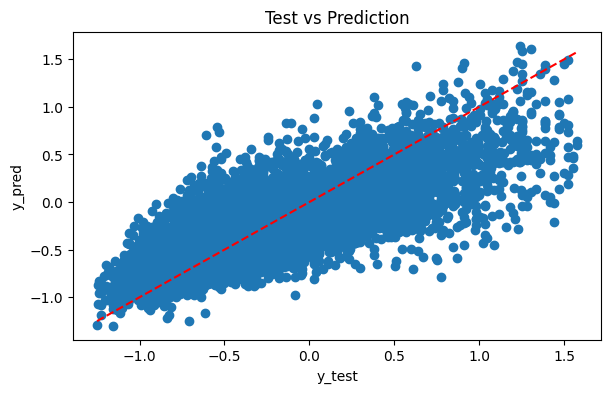

In [77]:
pred1 = poly_model.predict(X_poly)
pred2 = poly_model.predict(X_poly1)
Evaluate(0, pred1, pred2)

Increasing the degree to 3

In [78]:
poly = PolynomialFeatures(degree=3, include_bias=False)

In [79]:
X_poly = poly.fit_transform(train_df_X)
X_poly1 = poly.fit_transform(test_df_X)

In [80]:
poly_model = LinearRegression()

In [81]:
poly_model.fit(X_poly, train_df_y)

LinearRegression()

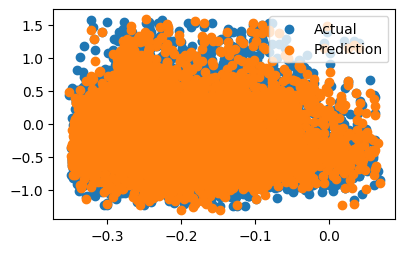



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.6397490464215847
Residual Sum of Squares (RSS) on Training set  ---> 857.6047602839478
Mean Squared Error (MSE) on Training set       ---> 0.09443946264551789
Root Mean Squared Error (RMSE) on Training set ---> 0.3073100431901272

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> -2.8191621852157394e+23
Residual Sum of Squares (RSS) on Training set  ---> 2.405298638615604e+26
Mean Squared Error (MSE) on Training set       ---> 7.414607394006178e+22
Root Mean Squared Error (RMSE) on Training set ---> 272297767049.34946

--------------------Residual Plots--------------------


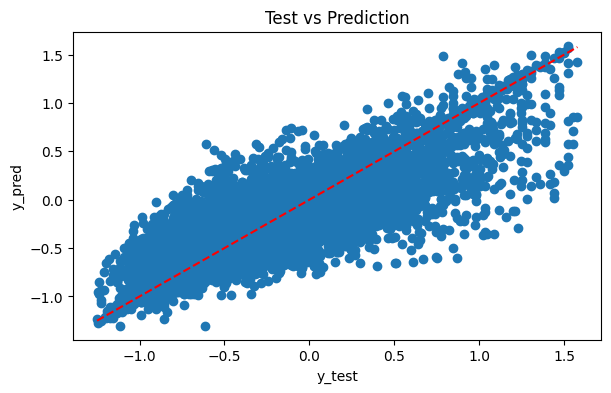

In [82]:
pred1 = poly_model.predict(X_poly)
pred2 = poly_model.predict(X_poly1)
Evaluate(0, pred1, pred2)

From our findings, we see that the polynomial regression with degree three yields the best accuracy.
Hence, using this to test with the validation dataset, we see.

In [86]:
X_poly = poly.fit_transform(train_df_X)
X_poly1 = poly.fit_transform(test_df_X)
X_poly2 = poly.fit_transform(val_df_X)

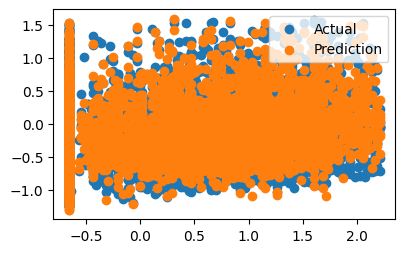



--------------------Training Set Metrics--------------------

R2-Score on Training set ---> 0.6397490464215847
Residual Sum of Squares (RSS) on Training set  ---> 857.6047602839478
Mean Squared Error (MSE) on Training set       ---> 0.09443946264551789
Root Mean Squared Error (RMSE) on Training set ---> 0.3073100431901272

--------------------Testing Set Metrics--------------------

R2-Score on Testing set ---> -2.8191621852157394e+23
Residual Sum of Squares (RSS) on Training set  ---> 2.405298638615604e+26
Mean Squared Error (MSE) on Training set       ---> 7.414607394006178e+22
Root Mean Squared Error (RMSE) on Training set ---> 272297767049.34946

--------------------Validating Set Metrics--------------------

R2-Score on Testing set ---> -1.0443107659494468e+22
Residual Sum of Squares (RSS) on Training set  ---> 1.0869535086751009e+25
Mean Squared Error (MSE) on Training set       ---> 2.79278907676028e+21
Root Mean Squared Error (RMSE) on Training set ---> 52846845475.96271

---

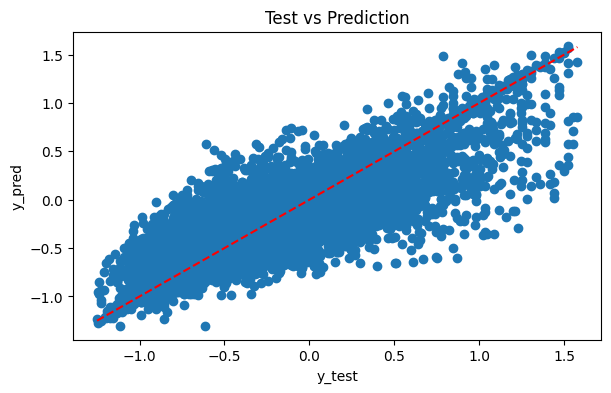

In [94]:
pred1 = poly_model.predict(X_poly)
pred2 = poly_model.predict(X_poly1)
pred3 = poly_model.predict(X_poly2)
Evaluate(0, pred1, pred2, pred3=pred3)

Saving model for later use

In [95]:
import pickle
filename = "final_project.pickle"
pickle.dump(poly_model, open(filename, "wb"))